<a href="https://colab.research.google.com/github/uol-mediaprocessing-202021/medienverarbeitung-b-color-and-tone-correction/blob/develop/Documentation_Group_B_Color_and_Tone_Correction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Introduction**
The module Media Processing is supervised by Prof. Dr. techn. Boll-Westermann and Dr.-Ing. Abdenebaoui and serves to teach the students how to deal with the technologies of media processing. The module is divided into lectures and practical exercises. In the lecture, among other things, the process of digital image creation, image processing and image storage will be discussed. Furthermore, students are taught how to analyze images. In addition, students are given an introduction to machine learning. In the specialized practical exercise, students are assigned topics in media processing, which they then work on in small groups. The students have one semester to deal more intensively with the subject matter and to apply the knowledge they have gained from the lecture in the exercise.

In this practical exercise we will deal with the topic of Color and Tone Correction. Tone correction is used to adjust the brightness and contrast of an image. It can happen that color deviations occur in the image due to the lighting conditions at the shooting location. Color correction deals with this problem and improves the color deviations so that the colors again correspond to a real condition. The goal of this professional hands-on exercise is to apply successful Color and Tone Correction to images.

For the professional practical exercise, the following scenario was created first:

*We took a lot of photos of landscapes, alleys and cities. Grandpa especially loves landscapes, which is why we want to give him a photo book for Christmas. Unfortunately, not all photos turned out to be colorful and we would like to include them in the photo book. Therefore, we would like to edit these photos in color.*

In order to obtain the optimal result of a Color and Tone Correction, we applied several methods and machine learning to different data sets. In this documentation, we will explain how we performed our practical exercise step by step and what results and conclusions we came to.  First we start with a slider, which changes the saturation, contrast and brightness of the image. This is followed by the edge detection. In the edge detection we focus on the Canny Edge Dectection and the grabCut. After the edge detection we focus on an algorithm for the rebalancing for the color distribution and a whitebalancing. Here, the methods are first considered separately and then applied in combination. Afterwards, the practical exercise is concluded with a machine learning part.

# **Slider**
Our very first approach to changing the Color / Tone involved a slider which was used to adjust certain parameters of any given image. We primarily used saturation, contrast and brightness to change the input image. We used these sliders to gain valuable insights on how these parameters affect images. Images are read and edited using the Pillow (PIL) / OpenCv (cv2) library. Images are often displayed using the matplotlib.pyplot libraray. The sliders were implemented as widgets using the ipywidgets library. First a function is created. This function defines the behaviour of the slider widget. The widget is created using the interact function from the ipywidgets library using an image and an integer (to determine the scope of the slider widget) as parameters. As the name implies one can interact with the now created slider widget. Doing this one can see the results displayed immediately. However it is advised to click on the spot where the slider should be set to instead of actually dragging the slider there. If the slider is dragged every possible image inbetween the current image and the target will be calculated and displayed. This results in a slow "animation".

In [ ]:
import PIL
from PIL import ImageEnhance
import numpy as np
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import cv2
import matplotlib.pyplot as plt

## Example 1
We chose a basic landscape picture featuring a meadow, a few bushes and some trees from a nearby forest. 

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
imagefile='/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/190.png'

In [ ]:
img = PIL.Image.open(imagefile)

After opening the image we reduce it for speeding up the calcuations. This results in roughly 750x550 preview images.

In [ ]:
reduced_img = img.reduce(5)

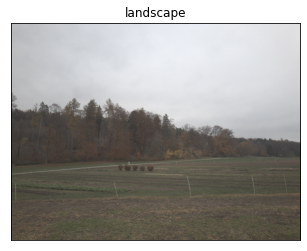

In [ ]:
plt.figure()
plt.title("landscape"), plt.xticks([]), plt.yticks([])
plt.imshow(reduced_img)
plt.show()

The function for the first slider is defined here. It changes the brightness of the input image using the Pillow library and afterwards displays the image.

In [ ]:
def f(x):
    preview_img = reduced_img
    converter = PIL.ImageEnhance.Brightness(reduced_img)
    img2 = converter.enhance(x/100)
    plt.imshow(img2)

The first slider (brightness):

In [ ]:
interact(f, x=100);

interactive(children=(IntSlider(value=100, description='x', max=300, min=-100), Output()), _dom_classes=('widg…

The function for the second slider (color /saturation) is defined here. It changes the saturation of the input image using the Pillow library and afterwards displays the image.

In [ ]:
def g(x):
    preview_img = reduced_img
    converter = PIL.ImageEnhance.Color(reduced_img)
    img3 = converter.enhance(x/100)
    plt.imshow(img3)

The second slider (using an increased saturation of 200 as a starting value):

In [ ]:
interact(g, x=200);

interactive(children=(IntSlider(value=200, description='x', max=600, min=-200), Output()), _dom_classes=('widg…

The original image for reference:

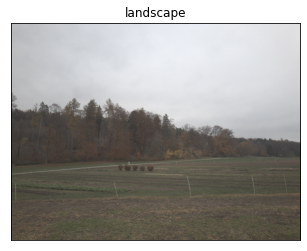

In [ ]:
plt.figure()
plt.title("landscape"), plt.xticks([]), plt.yticks([])
plt.imshow(reduced_img)
plt.show()

### Experimental editing using numpy
We also tried editing the image using the OpenCv library and numpy. To achieve this we converted the image data to int16 using numpy and afterwards used a formula to calculate new values for every pixel by multiplying all of the values with a calculated factor aswell as some substraction / addition. In the end the values have to be clipped to fit into 0-255 (rgb values) using numpy, so they can be converted to uint8 using numpy again.

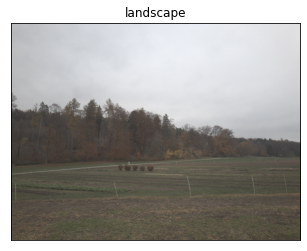

In [ ]:
plt.figure()
plt.title("landscape"), plt.xticks([]), plt.yticks([])
plt.imshow(reduced_img)
plt.show()

In [ ]:
brightness = -10
contrast = 35
img = np.int16(reduced_img)
img = img * (contrast/127+1) - contrast + brightness
img = np.clip(img, 0, 255)
img = np.uint8(img)

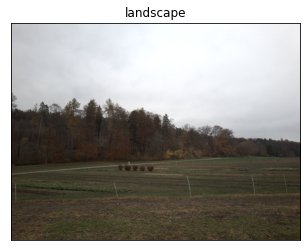

In [ ]:
plt.figure()
plt.title("landscape"), plt.xticks([]), plt.yticks([])
plt.imshow(img)
plt.show()

## Example 2

In [ ]:
imagefile = '/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/691.png'

In [ ]:
img = PIL.Image.open(imagefile)

In [ ]:
reduced_img = img.reduce(5)

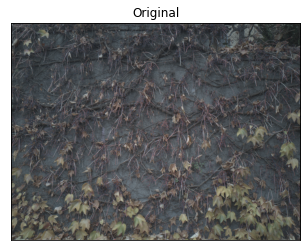

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(reduced_img)
plt.show()

In [ ]:
def f(x):
    preview_img = reduced_img
    converter = PIL.ImageEnhance.Brightness(reduced_img)
    img2 = converter.enhance(x/100)
    plt.imshow(img2)

In [ ]:
interact(f, x=100);

interactive(children=(IntSlider(value=100, description='x', max=300, min=-100), Output()), _dom_classes=('widg…

In [ ]:
def g(x):
    preview_img = reduced_img
    converter = PIL.ImageEnhance.Color(reduced_img)
    img3 = converter.enhance(x/100)
    plt.imshow(img3)

In [ ]:
interact(g, x=200);

interactive(children=(IntSlider(value=200, description='x', max=600, min=-200), Output()), _dom_classes=('widg…

#**Canny Edge Dectection**
After the variant of the slider worked, the group thought that the foreground should be separated from the background. The idea behind this is that the landscapes and objects in the foreground should stand out even more from the background. The automatic color adjustment should strengthen the foreground and the background only slightly. Furthermore, it should be avoided that the sky is seen as an object, so that it does not look unnatural after a color correction.

Accordingly, the group is looking for different edge detection algorithms to first highlight the objects of an image and then distinguish between foreground and background. Among other things, the group came across John F Canny's Canny Edge Dectection algorithm during their search.

## Description
The Canny Edge Dectection algorithm is an edge detection algorithm that is used for image noise removal and the precise localization of edges within an image. Originally, this algorithm was developed only for edge detection in gray-scale images, but now, by separating individual color components, it can also be applied to color images. The Canny Algorithm has the advantage that it does not only want to achieve three goals at the same time, but also determines connected chains of edge elements, which should facilitate the post-processing. At its core, the Canny algorithm, like many others, uses the gradient method. This algorithm can be divided into several steps. 

In the first step, the three separated color components red, green, blue are smoothed using a Gaussian filter of width σ to suppress the noise effects of the original image. After that, the image is filtered with a Sobel kernel in horizontal and vertical direction. Now the first derivatives *Gx* and *Gy* can be derived. With the help of these derivatives now the edge gradients, as well as the directions of the pixels can be determined.

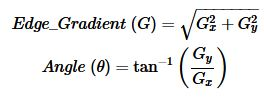

After the gradient and the directions of the pixels have been determined, all pixels that do not belong to an edge are removed. To find out whether a pixel belongs to an edge, the neighboring pixel is checked for a local maximum and minimum. If the neighboring pixel is a minimum or maximum, the pixel actually examined is still considered as an edge pixel. If no neighbor is a minimum or maximum, the edge pixel is set to 0.  

Last but not least, it is determined whether the remaining pixels that would form an edge are relevant for the algorithm or not. For this, two threshold values *minVal* and *maxVal* have to be set. If the maximum of the pixel exceeds the threshold value *maxVal*, it is certainly a relevant edge pixel. If a maximum is below the threshold *minVal*, then the edge is not relevant and is discarded. If a maximum is between the thresholds, then it is unclear whether the edge is a relevant edge or not.  

In [ ]:
import cv2
import math
import numpy as np
import sys
import matplotlib.pyplot as plt

## Example 1
In this example, you can clearly see that the Canny algorithm perceives the edges of the palm tree and the fence more strongly than the mountains that can be seen in the background or the sea. All larger black areas and all areas where the edges are very thin, such as the mountains, represent the background.

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/landscape/00000116_(4).jpg')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

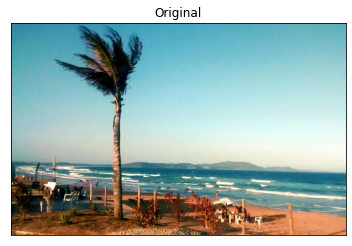

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(RGB_src)
plt.show()

In [ ]:
canny = cv2.Canny(img, 200,400)

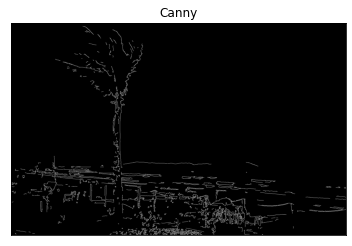

In [ ]:
plt.figure()
plt.title("Canny"), plt.xticks([]), plt.yticks([])
plt.imshow(canny, 'gray')
plt.show()

## Example 2
With the image from example 2, the group tests some limits. This is a plant shimmying broadly along a surface. Here it is difficult to tell what is the foreground and what is the background. The group figured that the leaves and branches are the foreground and the surface is the background. In the first Canny version, it is clear that the detection of the edges is not clear. The lower leaves disappear altogether and only in the middle are some edges of the branches detected. This may be due to the fact that the two threshold values minVal and maxVal are chosen too high and thus many possible edge pixels are not detected as edge pixels with it.

Accordingly, the filter is applied over the image again, but this time with lower thresholds. The result is that the edges are displayed more strongly, but still the edges of the leaves are not clearly recognizable or which edges belong to the leaves.

In [ ]:
img2 = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/691.png')
RGB_src2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

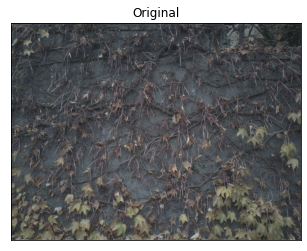

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(RGB_src2)
plt.show()

In [ ]:
canny2a = cv2.Canny(img2, 200,400)

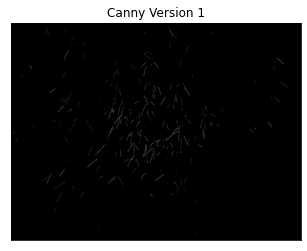

In [ ]:
plt.figure()
plt.title("Canny Version 1"), plt.xticks([]), plt.yticks([])
plt.imshow(canny2a, 'gray')
plt.show()

In [ ]:
canny2b = cv2.Canny(img2, 100,200)

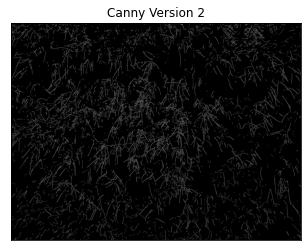

In [ ]:
plt.figure()
plt.title("Canny Version 2"), plt.xticks([]), plt.yticks([])
plt.imshow(canny2b, 'gray')
plt.show()

## Example 3
The third example was not as challenging as the second example. The edges of the objects in the foreground were quickly and for the most part clearly detected by the algorithm. Again, the thresholds chosen for the second Canny version of the second example did not make sense for this image. The edges are too dense, as can be seen in version 1. It is clear where which object should be, but for example the edges of the human are hardly distinguishable from the path. The same applies to the edges of the two trees on the right side. Accordingly, again a Canny algorithm with higher thresholds is applied. In the result the edges of the foreground are clearly recognizable.

In [ ]:
img3 = cv2.imread('/content/gdrive/MyDrive/landscape/00000002.jpg')
RGB_src3 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)

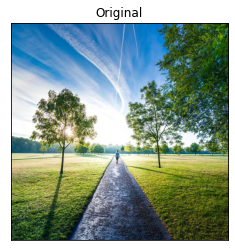

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(RGB_src3)
plt.show()

In [ ]:
canny3a = cv2.Canny(img3, 100,200)

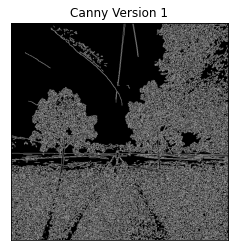

In [ ]:
plt.figure()
plt.title("Canny Version 1"), plt.xticks([]), plt.yticks([])
plt.imshow(canny3a, 'gray')
plt.show()

In [ ]:
canny3b=cv2.Canny(img3, 250,500)

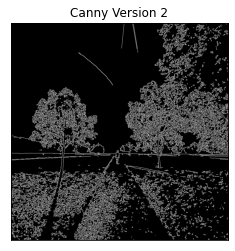

In [ ]:
plt.figure()
plt.title("Canny Version 2"), plt.xticks([]), plt.yticks([])
plt.imshow(canny3b, 'gray')
plt.show()

## Example 4

Example 4 seemed to be a challenge again. Especially the fog causes some problems with the edge detection. Even after adjusting the thresholds, the edge pixels of the mountains are not clearly recognizable as edge pixels. Again, the edges of the trees, after changing the thresholds, are quite clearly recognizable. However, exactly what kind of trees they are cannot be easily identified by the edges found by the Canny algorithm.

In [ ]:
img4 = cv2.imread('/content/gdrive/MyDrive/landscape/00000150_(6).jpg')
RGB_src = cv2.cvtColor(img4, cv2.COLOR_BGR2RGB)

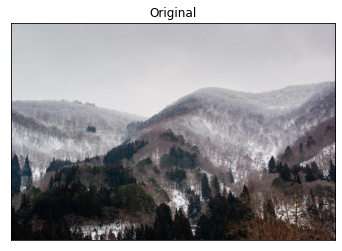

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(RGB_src)
plt.show()

In [ ]:
canny4a = cv2.Canny(img4, 250,500)

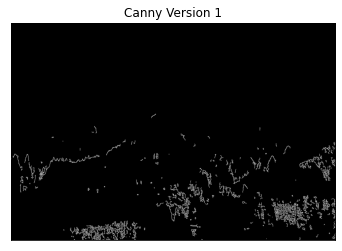

In [ ]:
plt.figure()
plt.title("Canny Version 1"), plt.xticks([]), plt.yticks([])
plt.imshow(canny4a, 'gray')
plt.show()

In [ ]:
canny4b = cv2.Canny(img4, 100,200)

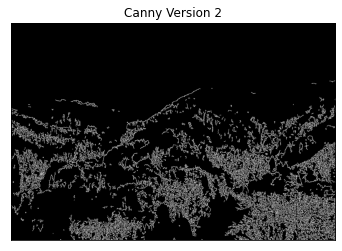

In [ ]:
plt.figure()
plt.title("Canny Version 2"), plt.xticks([]), plt.yticks([])
plt.imshow(canny4b, 'gray')
plt.show()

## Example 5

With this image, the group has once again reached the limits of the Canny algorithm. Even after the thresholds are lowered, it is difficult to tell which objects are on this image based on the edges and its pixels. The edges of the tree tops can be seen, but the edges of the objects that are on the meadow are hard to see.

In [ ]:
img5 = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/190.png')
RGB_src = cv2.cvtColor(img5, cv2.COLOR_BGR2RGB)

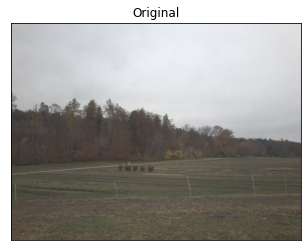

In [ ]:
plt.figure()
plt.title("Original"), plt.xticks([]), plt.yticks([])
plt.imshow(RGB_src)
plt.show()

In [ ]:
canny5a = cv2.Canny(img5, 100,200)

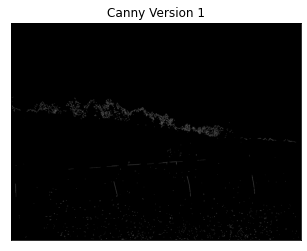

In [ ]:
plt.figure()
plt.title("Canny Version 1"), plt.xticks([]), plt.yticks([])
plt.imshow(canny5a, 'gray')
plt.show()

In [ ]:
canny5b = cv2.Canny(img5, 50,100)

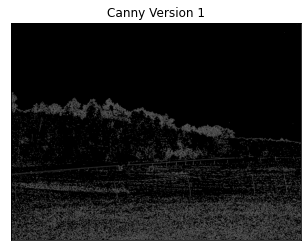

In [ ]:
plt.figure()
plt.title("Canny Version 1"), plt.xticks([]), plt.yticks([])
plt.imshow(canny5b, 'gray')
plt.show()

## Conclusion
The Canny algorithm is not suitable for every image, as example 2 proved. Not always all edges of all objects are detected unambiguously. Furthermore, the thresholds for edge detection have to be adjusted again depending on the image. Therefore, the group decided to discontinue the Canny algorithm approach and to search for an edge detection algorithm that directly and unambiguously separates the objects or foreground from background.

#**grabCut**
After it turned out that the desired goal is not achieved with the Canny algorithm and the group decided not to continue using this algorithm, the group takes a closer look at the grabCut algorithm. This time the idea is that it might make more sense to separate the foreground directly from the background or the landscape from the sky and not to search for the objects by a pure edge detection first.

## Description
The GrabCut algorithm is an iterative edge detection algorithm developed by Carsten Rother, Vladimir Kolmogorov and Andrew Blank. GrabCut is about separating the foreground from the background. To do this, a rectangle is placed around the foreground. Everything around the rectangle is recognized as background. Then a Gaussian Mixture Model (GMM) is used to model the foreground and background and a new pixel distribution is made to assign pixels that are still unknown to the foreground or background. Now, from the pixel distribution, a graph is created with the pixel nodes, a source node and sink nodes. The foreground pixels are source nodes and the background pixels are sink nodes. 
Next, a mincut algorithm is applied over the graph. In this process, the graph is segmented. The graph is cut into source nodes and sink nodes with the minimum cost function. 
Last but not least, a border is placed around the foreground and the background is blackened.

In [ ]:
import cv2
import math
import numpy as np
import sys
import matplotlib.pyplot as plt

## Example 1
In the first example, the grabCut gives a pretty good result, as can be seen in the left image. The airplane is still outlined by a few pixels of the background, but the background is neatly separated from the foreground by blackening the background completely.

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/archive/natural_images/airplane/airplane_0006.jpg')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

create mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (4,4,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

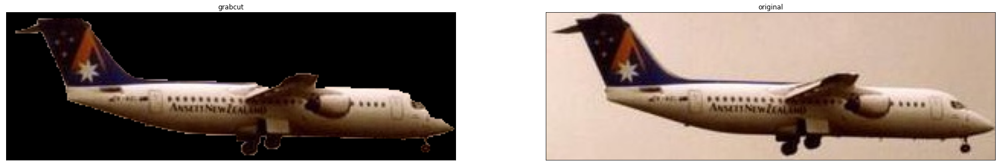

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 2
The second example is an image with two objects that should be separated from the rest of the image. Here, the grabCut algorithm seems to be an inappropriate choice. Even after adjusting the mask, a piece of the beach that should be blackened is still visible in color. Even when the landscape should be separated from the sky, the grabCut proves to be an inappropriate algorithm for this task at this point. As can be seen in the first comparison of this example, the water is also recognized as sky and is itself partially blackened behind the second stone.

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/landscape/00000115_(6).jpg')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

create mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (4,4,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

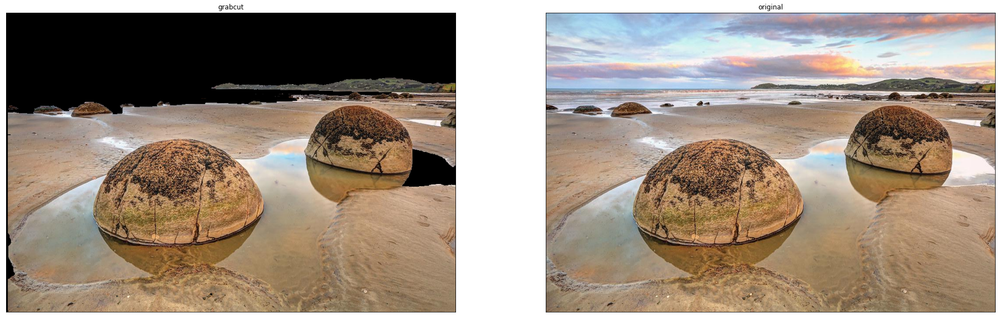

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

create new mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (240,240,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

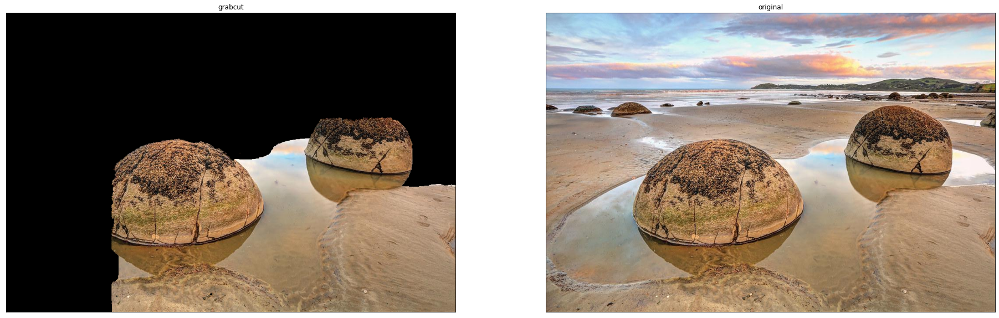

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 3

In the third example, the grabCut proves to be very inappropriate. The sky and the landscape are not completely separated from each other and even after adjusting the mask a piece of the sky is still visible. Furthermore, after adjusting the mask, a piece of the landscape is also blackened at the edge.


In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/landscape/00000082_(3).jpg')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

create mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (4,4,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

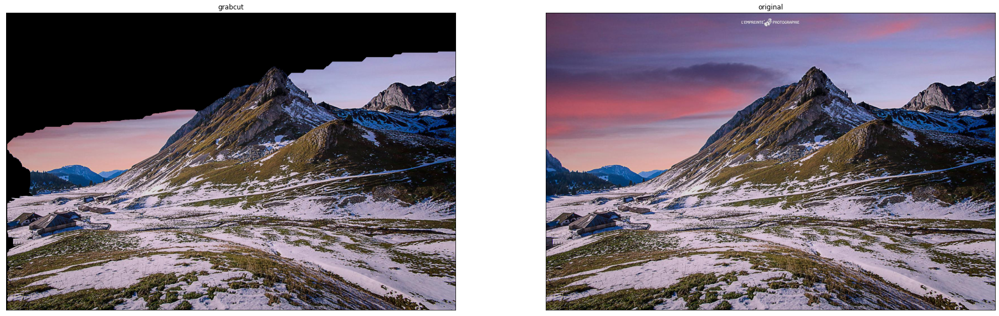

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

create new mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (200,200,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

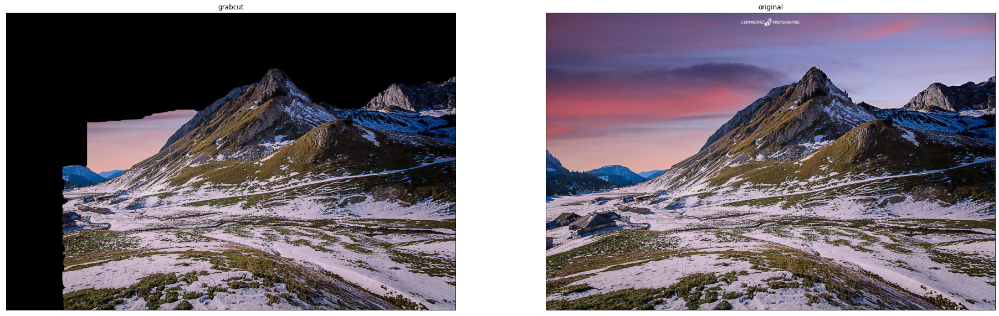

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 4

Example 4 gives a similar nice result as example 1. Although a small piece of landscape is blackened, it is clear to see what should be the foreground and what the background.

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/landscape/00000066_(4).jpg')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

create mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (4,4,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

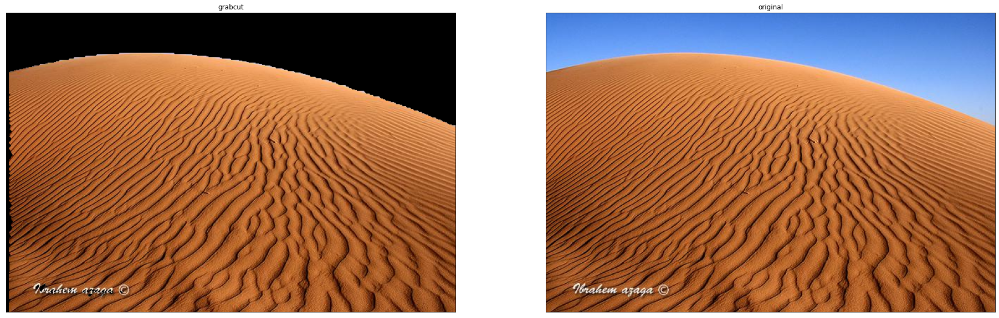

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 5

Example 5 is a standard example of the group, which runs through every method. The grabCut algorithm delivers a very nice result in this example. The sky is completely blackened and the landscape is highlighted. There are very clean edges and no blackening of the landscape in this example.

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/190.png')
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

create mask

In [ ]:
mask = np.zeros(img.shape[:2], np.uint8)
bgdModel =  np.zeros((1,65),np.float64)
fgdModel =  np.zeros((1,65),np.float64)
x = img.shape[1]
y = img.shape[0]

rectangle: Since we dont know where the foreground objects are located in any given picture, we have to give the full resolution via the parameters x and y

In [ ]:
rect = (4,4,x,y)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2  =  np.where((mask==2)|(mask==0),0,1).astype('uint8')
img  = img*mask2[:,:,np.newaxis]

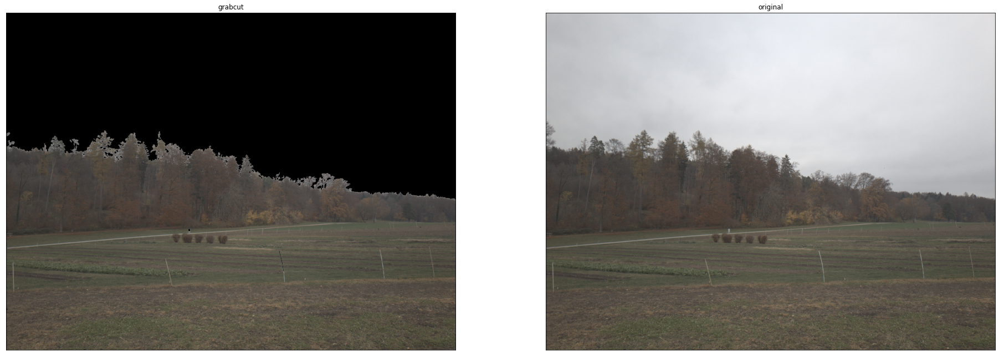

In [ ]:
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_img)
plt.title("grabcut"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.show()

## Conclusion
The Grab Cut in the Color and Tone Correction project was originally intended to automatically and precisely separate the foreground from the background, or the landscape from the sky, so that separate color enhancement of the background and foreground could be applied. This did not work everywhere as hoped. As can be seen especially in Example 3, the separation of foreground and background did not run as expected for every image. Even after adjusting the mask, elements of the sky were still shown that should have been blackened. Furthermore, in examples 2,3 and 4, a problem was that part of the landscape was blacked out as well, even though it shouldn't have been.

Even though Example 1 and Example 5 met the group's expectations, the group decided not to continue using the grabCut because of the results from Examples 2, 3 and 5.

# **Color and Tone Correction using Rebalancing**
Next up we spent some time researching and found an algorithm dedicated to rebalancing the colors in a given image. The algorithm uses a mask to rebalance the colors in the given image.
To achieve this several functions are needed. The first function determines how the mask will be applied onto the given image. This function uses the numpy library and returns a filled mask. 

The next function determines how the threshold of the mask will be applied. This function uses the first function and returns the matrix after the mask was applied.

The third function uses the OpenCv, numpy and math libraries. This function also uses the second function.
Inside the script the third function gets called:

Script -> Third Function -> Second function -> first function

After some testing later on and not being 100% satisfied with the results (some pictures looked like they were overexposed), we added white balancing via OpenCV just before the rebalancing happens. This allowed to decrease the "overexposed effect" we were seeing on some of our images.

## What is Whitebalance?
In photography, white balance is the process of adjustment of colors to make them appear less artificial / more natural in images. These adjustments can be done by the camera (automatic / manual) or later on while processing / editing the image. For white balancing the baseline is set by detecting the "temperature" of the lighting which is found in the picture. The "temperature" is measured in Kelvin (just like real temperatures). An image showing different Adjustments based on teh temperatue of the light can be found below.

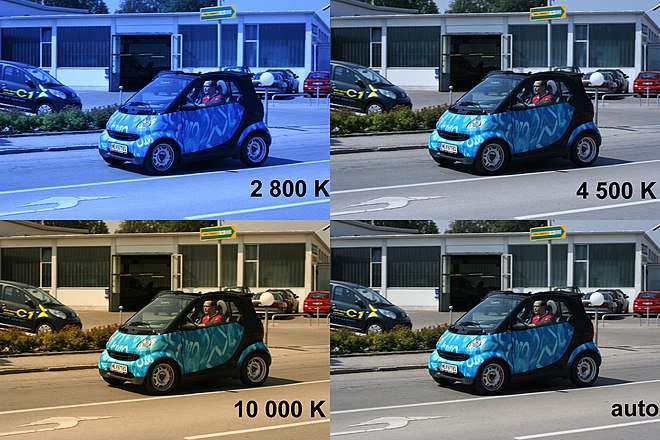


The fully automatic white balance consists of two strategies. The first strategy is that the program assumes that the largest bright area on the image is white or neutral gray and then finally selects it for correction. If the assumption is correct, the correction achieves a good result. The second strategy is based on the assumption that there are no larger neutral gray areas. If this is the case, then the program assumes that all colors are present in the image. For example, if the image contains no blue color, the white balance will assign blue color components to the image everywhere. The disadvantage of fully automatic white balance is that it is not suitable for shooting in twilight.  (source: https://de.wikipedia.org/wiki/Wei%C3%9Fabgleich)

In [ ]:
import cv2
import math
import numpy as np
import sys
import matplotlib.pyplot as plt

First function:

In [ ]:
def apply_mask(matrix, mask, fill_value):
    masked = np.ma.array(matrix, mask=mask, fill_value=fill_value)
    return masked.filled()

Second function:

In [ ]:
def apply_threshold(matrix, low_value, high_value):
    low_mask = matrix < low_value
    matrix = apply_mask(matrix, low_mask, low_value)

    high_mask = matrix > high_value
    matrix = apply_mask(matrix, high_mask, high_value)

    return matrix

Third function:

In [ ]:
def simplest_cb(img, percent):
    assert img.shape[2] == 3
    assert percent > 0 and percent < 100

    half_percent = percent / 200.0

    channels = cv2.split(img)

    out_channels = []
    for channel in channels:
        assert len(channel.shape) == 2
        # find the low and high precentile values (based on the input percentile)
        height, width = channel.shape
        vec_size = width * height
        flat = channel.reshape(vec_size)

        assert len(flat.shape) == 1

        flat = np.sort(flat)

        n_cols = flat.shape[0]
        print(flat.shape)
        print(n_cols)
        
        
        
        low_val  = flat[math.floor(n_cols * half_percent)]
        high_val = flat[math.ceil( n_cols * (1.0 - half_percent))]

        print ("Lowval: ", low_val)
        print ("Highval: ", high_val)

        # saturate below the low percentile and above the high percentile
        thresholded = apply_threshold(channel, low_val, high_val)
        # scale the channel
        normalized = cv2.normalize(thresholded, thresholded.copy(), 0, 255, cv2.NORM_MINMAX)
        out_channels.append(normalized)

    return cv2.merge(out_channels)

## Example 1
Reading in a sample image and running it through the algorithm:

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/691.png')
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(11808768,)
11808768
Lowval:  36
Highval:  157
(11808768,)
11808768
Lowval:  34
Highval:  161
(11808768,)
11808768
Lowval:  31
Highval:  164


Displaying the outcome and the original image side by side:

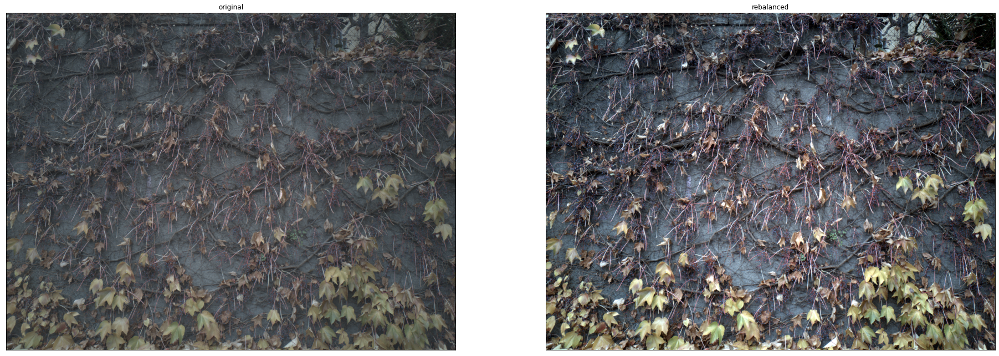

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 2
Loading in a second sample image

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/archive/natural_images/airplane/airplane_0006.jpg')
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(28615,)
28615
Lowval:  0
Highval:  238
(28615,)
28615
Lowval:  0
Highval:  241
(28615,)
28615
Lowval:  17
Highval:  255


And displaying it side by side with the original one

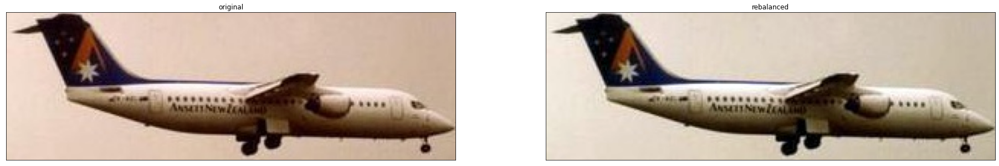

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 3

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/archive/natural_images/airplane/airplane_0002.jpg')
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(27260,)
27260
Lowval:  0
Highval:  173
(27260,)
27260
Lowval:  0
Highval:  198
(27260,)
27260
Lowval:  16
Highval:  255


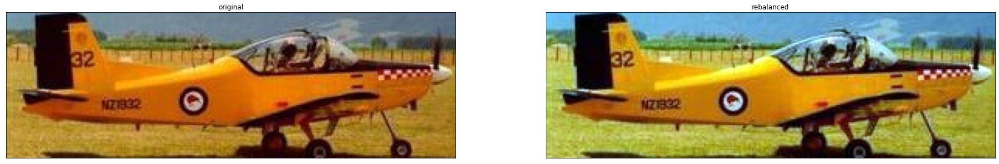

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([]) 
plt.show()

## Example 4

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/landscape/00000002.jpg')
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(640000,)
640000
Lowval:  0
Highval:  255
(640000,)
640000
Lowval:  7
Highval:  255
(640000,)
640000
Lowval:  0
Highval:  255


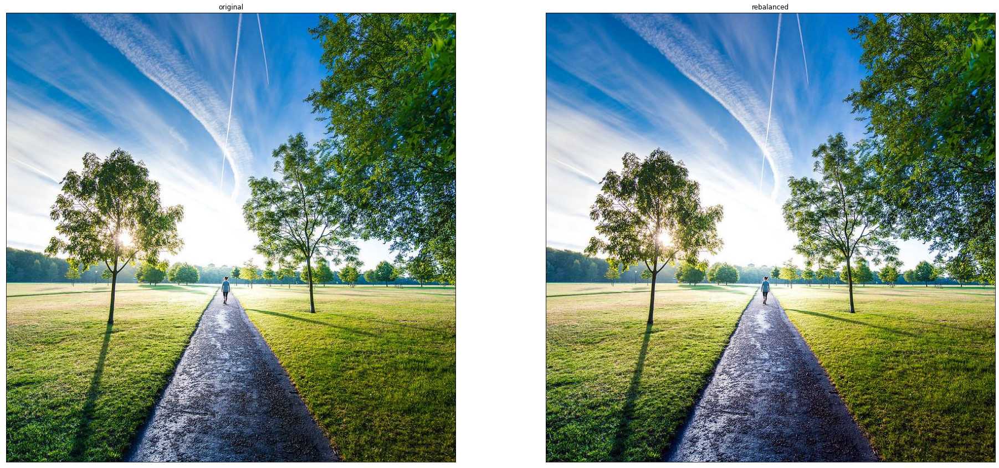

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 5

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/190.png')
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(11808768,)
11808768
Lowval:  48
Highval:  246
(11808768,)
11808768
Lowval:  54
Highval:  240
(11808768,)
11808768
Lowval:  56
Highval:  238


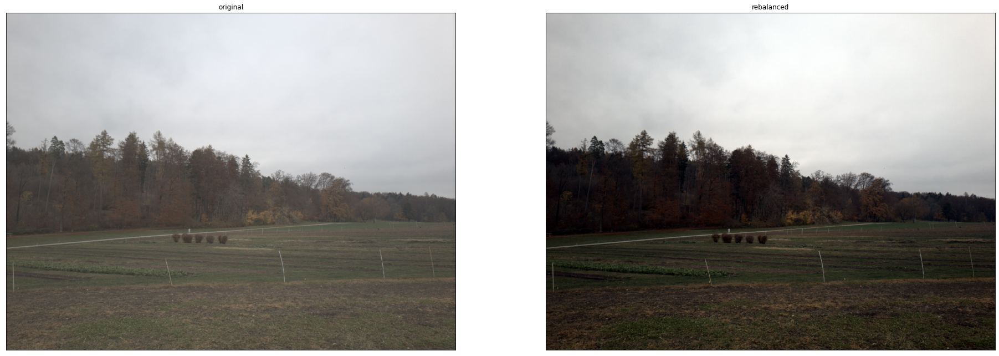

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),  plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

## Example 6
Another sample, but now we add white balancing right before we rebalance the colors

In [ ]:
img = cv2.imread('/content/gdrive/MyDrive/Zurich-RAW-to-DSLR-Dataset/full_resolution/huawei_visualized/6692.png') 
out = simplest_cb(img, 1)
RGB_src = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
RGB_out = cv2.cvtColor(out, cv2.COLOR_BGR2RGB)

(11808768,)
11808768
Lowval:  18
Highval:  196
(11808768,)
11808768
Lowval:  21
Highval:  196
(11808768,)
11808768
Lowval:  16
Highval:  197


Automatic white balancing added via OpenCVs SimpleWB

In [ ]:
wb = cv2.xphoto.createSimpleWB()
wb_image = wb.balanceWhite(img)
RGB_image = cv2.cvtColor(wb_image, cv2.COLOR_BGR2RGB)

side by side original and rebalanced

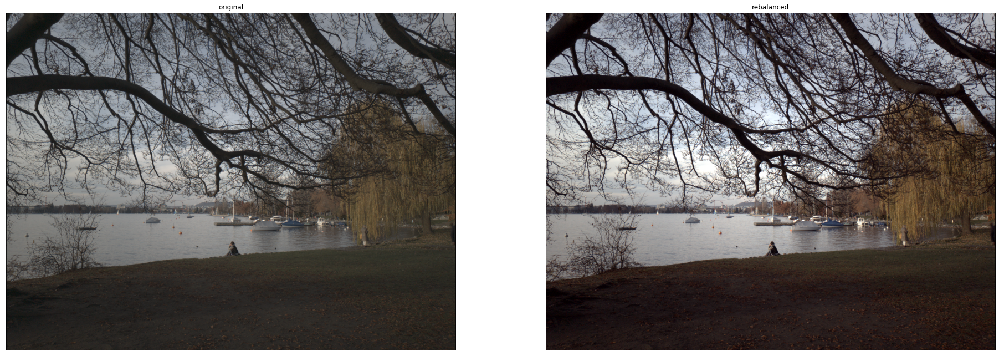

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121), plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

side by side original and white balanced

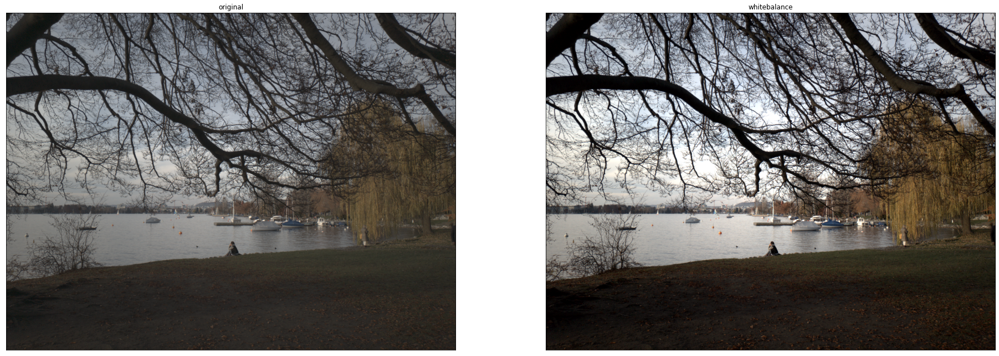

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_image)
plt.title("whitebalance"), plt.xticks([]), plt.yticks([])
plt.show()

Now add the color rebalancing:

In [ ]:
wb_out = simplest_cb(wb_image, 1)
RGB_wb_out = cv2.cvtColor(wb_out, cv2.COLOR_BGR2RGB)

(11808768,)
11808768
Lowval:  0
Highval:  255
(11808768,)
11808768
Lowval:  0
Highval:  255
(11808768,)
11808768
Lowval:  0
Highval:  255


Now it's time for some side by side comparisons:

First: only whitebalanced vs whitebalanced + rebalanced

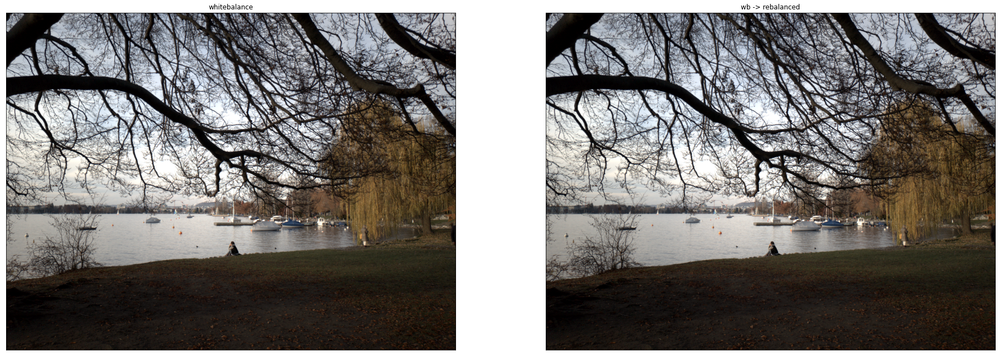

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),
plt.imshow(RGB_image)
plt.title("whitebalance"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_wb_out)
plt.title("wb -> rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

Second: only rebalanced vs whitebalanced + rebalanced

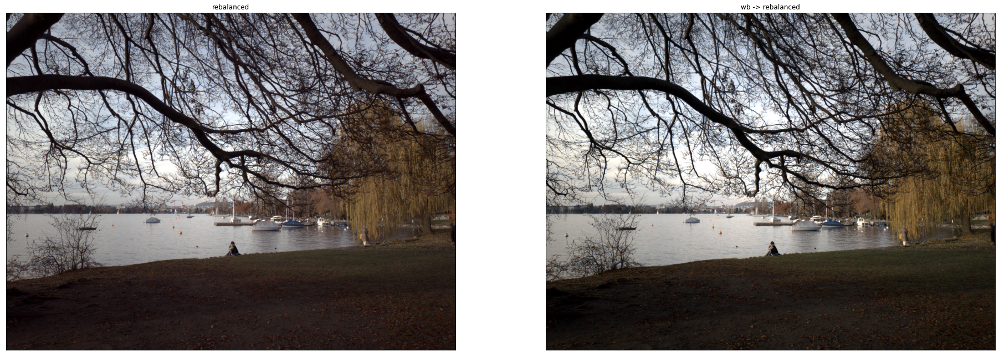

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),
plt.imshow(RGB_out)
plt.title("rebalanced"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_wb_out)
plt.title("wb -> rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

Original vs whitebalanced + rebalanced

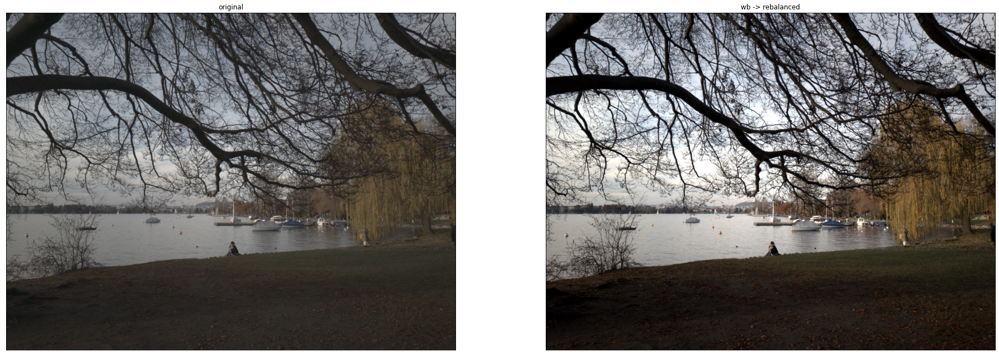

In [ ]:
plt.figure(figsize=(32,16))
plt.subplot(121),
plt.imshow(RGB_src)
plt.title("original"), plt.xticks([]), plt.yticks([])
plt.subplot(122),
plt.imshow(RGB_wb_out)
plt.title("wb -> rebalanced"), plt.xticks([]), plt.yticks([])
plt.show()

## Conclusion
You can clearly see in the images that the whitebalancing has made a color correction in the images. In combination with rebalancing, white balance has been our best solution so far. Let's take the last image in this chapter as an example. Here we see that by applying the rebalancing and whitebalancing together, the image is more like reality. The colors are more intense, the outlines and shadows on the image are clearer and the image is brighter. The only problem with using these methods is that the sky on some images is still quite artificial. To fix this problem we focus on machine learning to obtain an optimal solution.

#**Machine Learning**
After trying to improve images with color and white balancing we decided to give machine learning a try. We decided to use a pre trained model from https://github.com/aiff22/DPED (paper: https://arxiv.org/pdf/1704.02470.pdf, project webpage: http://people.ee.ethz.ch/~ihnatova/index.html). In this paper the main objective is to improve pictures from smartphones. This is done by 'comparison' to the same picture taken with a proper DSLR (canon). We used Smartphone pictures and DSLR Pictures provided by the PyNET project (http://people.ee.ethz.ch/~ihnatova/pynet.html). This dataset is from the same institution (ETH Zürich), but uses a more modern smartphone.
The CNN they provided is a so called GAN (Generative Adversarial Network). A GAN consists of 2 different Networks. They basically work "against" each other. On a general scale the generator tries to generate something that appears to be real. On the other side the discriminator tries to discern whether the generated thing is real or generated by the generator. In our case that means the generator tries to generate a DSLR-equivalent image from the smartphone image. The discriminator tries to discern whether the image is generated by the generator or taken by an actual DSLR. The discriminator is basically a classifier, whilst the actual image is generated by the generator.

![gan_diagram.svg](attachment:gan_diagram.svg)

source: https://developers.google.com/machine-learning/gan/gan_structure 

In [ ]:
import tensorflow as tf
import keras
import numpy as np
import cv2
import matplotlib.pyplot as plt
import sys

accessing files on Google Drive

In [ ]:
%cd /content/gdrive/MyDrive/DPED-master/DPED-master/

In [ ]:
!python load_dataset.py model=iphone

In [ ]:
!python train_model.py model=iphone train_size=10019

In [ ]:
!python test_model.py model=iphone iteration=18000 test_subset=full use_gpu=true

# **Conclusion**